In [1]:
import time
import functools
import os

import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

import IPython.display

import tensorflow as tf
from tensorflow.keras.preprocessing import image as kp_image
from tensorflow.keras.models import Model

In [2]:
def load_image(image_path):
  image = Image.open(image_path)
  old_dimensions = image.size

  image = image.resize((512, 512), Image.ANTIALIAS)
  image = kp_image.img_to_array(image) 
  
  image = np.expand_dims(image, axis=0)
  return image, old_dimensions


def show_image(image, title):

  if len(image.shape) > 3:
    image = np.squeeze(image, axis=0)
  image = image.astype('uint8')

  fig, axis = plt.subplots(1, 1, figsize=(14, 7))
  
  axis.imshow(image)
  axis.set_title(title)
  
  plt.show()

In [8]:
content_path = 'images' + os.path.sep + 'content1.jpg'
style_path = 'images' + os.path.sep + 'munch-the-scream.jpg'

content_image, _ = load_image(content_path)
style_image, _6 = load_image(style_path)

content_image.shape, style_image.shape

((1, 512, 512, 3), (1, 512, 512, 3))

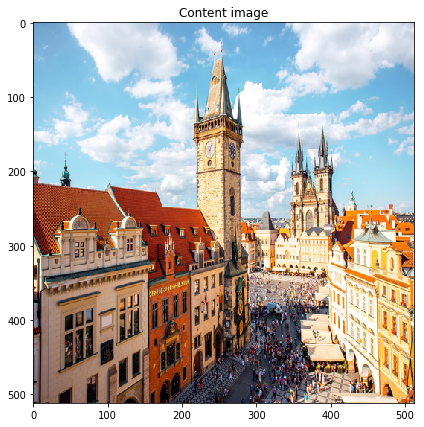

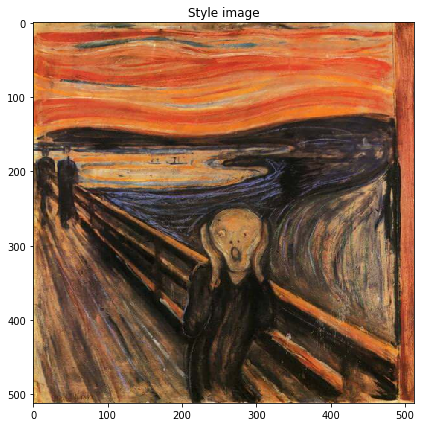

In [9]:
show_image(content_image, 'Content image')
show_image(style_image, 'Style image')

In [6]:
vgg_19_model = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

for layer in vgg_19_model.layers:
  print(layer.name)

input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [7]:
vgg_16_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')
for layer in vgg_16_model.layers:
  print(layer.name)

input_3
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_pool


In [10]:
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

content_layers = ['block5_conv2'] 

number_of_style_layers = len(style_layers)
number_of_content_layers = len(content_layers)

In [11]:
def build_model(vgg_model, content_layers, style_layers):
  vgg_model.trainable = False
  
  output_layers = [vgg_model.get_layer(layer).output for layer in style_layers + content_layers]
  
  model = Model(vgg_model.input, output_layers)
  
  return model

In [25]:
def deprocess_the_image(processed_image):

  vgg_means = np.array([102.738, 113.789, 120.18])

  x = processed_image.copy()
  if len(x.shape) == 4:
    x = np.squeeze(x, 0)
  if len(x.shape) != 3:
    raise ValueError("##############################Error: Dimension of image [height, width, channel] or [1, height, width, channel] ################################### ")


  x[:, :, 0] += vgg_means[0]
  
  x[:, :, 1] += vgg_means[1]
  
  x[:, :, 2] += vgg_means[2]
  
  x = x[:, :, ::-1]

  x = np.clip(x, 0, 255).astype('uint8')
  return x

In [13]:
'''
    F is the feature represenatation of image in given layer,
    N represents the number of distinct filters in a given layer,
    M is the size of the feature map in the given layer,
    Gram Matrix for the calculation of style loss,
'''
def gram_matrix(F, N, M):

  F = tf.reshape(F, (M, N))
  
  return tf.matmul(tf.transpose(F), F)

In [14]:
'''
    G and O are the feature representations of generated and original image",
    Calculate the content loss
'''
def calculate_content_loss(G, O):
  return tf.reduce_mean((G - O)**2)

In [15]:
'''
 o is the feature representation of the style image at given layer,
 g is the feature representation of the generated image at given layer,
 Calculate the style at a certain layer
'''
def calculate_style_loss(g, o):
  
  height, width, N = g.get_shape().as_list()
  
  M = height * width
  
  G = gram_matrix(g, N, M)
  O = gram_matrix(o, N, M)
  
  E = tf.reduce_sum((G - O) ** 2) / (4 * (N**2) * (M**2))
  return E

In [16]:
'''
    Calcluate the total loss using style loss and content loss
'''
def calculate_loss(model, style_weight, content_weight, original_image, style_features, content_features):

  model_outputs = model(original_image)
  
  content_output_features = model_outputs[number_of_style_layers:]
  style_output_features = model_outputs[:number_of_style_layers]

  content_loss = 0
  style_loss = 0


  weight_style = 1.0 / float(number_of_style_layers)
  
  for target_content, generated_content in zip(content_features, content_output_features):
    content_loss += calculate_content_loss(generated_content[0], target_content)
  
  for target_style, generated_style in zip(style_features, style_output_features):
    style_loss += weight_style * calculate_style_loss(generated_style[0], target_style)
    
  content_loss *= content_weight
  style_loss *= style_weight

  total_loss = style_loss + content_loss 

  return total_loss, style_loss, content_loss

In [18]:
'''
    Style Transfer Algorithm implmentation
'''
def style_transfer(content_path, style_path, vgg_model, iterations=500, content_weight=1000.0, style_weight=0.01, print_images=False, show_loss=False): 
  
  model = build_model(vgg_model, content_layers, style_layers)
  
  for layer in model.layers:
    layer.trainable = False

  original_image, _ = load_image(content_path)
  
  style_image, _ = load_image(style_path)
  content_image, content_of_old_dimenions = load_image(content_path)

  original_image = tf.keras.applications.vgg19.preprocess_input(original_image)
  original_image = tf.Variable(original_image, dtype=tf.float32)
  
  style_image = tf.keras.applications.vgg19.preprocess_input(style_image)
  content_image = tf.keras.applications.vgg19.preprocess_input(content_image)
   
  content_image_outputs = model(content_image)

  style_image_outputs = model(style_image)

  style_features = [style_layer[0] for style_layer in style_image_outputs[:number_of_style_layers]]
  content_features = [content_layer[0] for content_layer in content_image_outputs[number_of_style_layers:]]
  
  optimizer = tf.optimizers.Adam(learning_rate=5, beta_1=0.99, epsilon=1e-1)

  start_time = time.time()
  
  final_image =  None
  
  final_loss = float('inf')
  
  losses = []

  image_interval = iterations / 10
  
  
  for i in range(iterations):
    
    with tf.GradientTape() as tape: 
      total_loss, style_score, content_score = calculate_loss(model, style_weight, content_weight, original_image, style_features, content_features)
      gradients = tape.gradient(total_loss, original_image)
    
    optimizer.apply_gradients([(gradients, original_image)])

    losses.append(total_loss)

    if total_loss < final_loss:
      final_loss = total_loss
      final_image = deprocess_the_image(original_image.numpy())

    if print_images:
      if (i % image_interval == 0) or (i == iterations-1):
        plot_image = original_image.numpy()
        plot_image = deprocess_the_image(plot_image)
        
        show_image(plot_image, 'Stylized image')
        
        print('Iteration: {0}, style score: {1}, content score: {2}, total loss: {3}'
        .format(i, style_score, content_score, total_loss))

  if show_loss:
    plt.plot(range(iterations), losses)
    plt.show()

  print('Stylizing of image took {0}s'.format(time.time() - start_time))
  
  final_image = Image.fromarray(final_image).resize(content_of_old_dimenions, Image.ANTIALIAS)

  return final_image, final_loss 

In [19]:
'''
    Function to display the style transferred image
'''
def display_style_transferred_image(style_transferred_image, k=1):
  plt.figure(figsize=(style_transferred_image.size[0]/(96 * k), style_transferred_image.size[1]/(96 * k)))
  
  plt.imshow(style_transferred_image)
  
  plt.axis('off')
  
  plt.show()

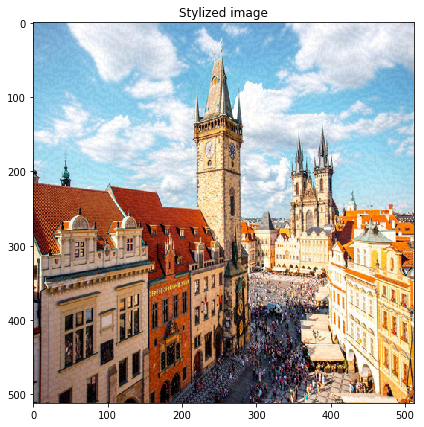

Iteration: 0, style score: 1066892992.0, content score: 0.0, total loss: 1066892992.0


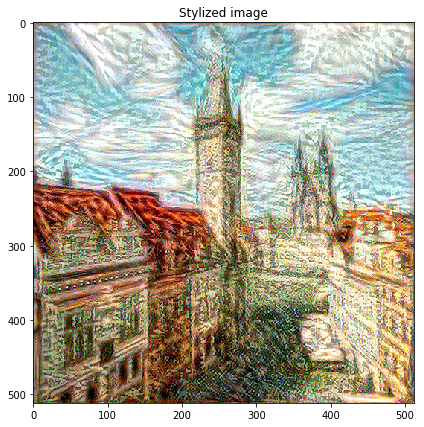

Iteration: 50, style score: 64504768.0, content score: 5205403.5, total loss: 69710168.0


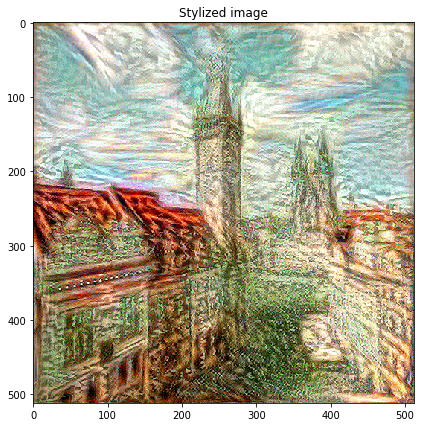

Iteration: 100, style score: 29965686.0, content score: 5158904.5, total loss: 35124592.0


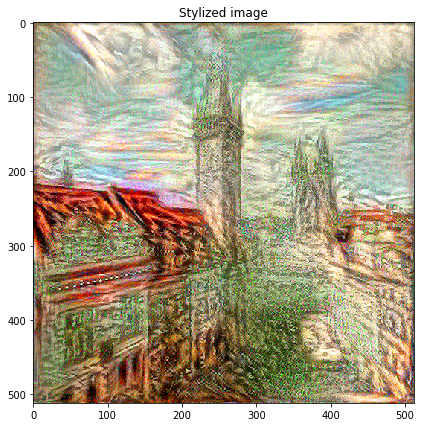

Iteration: 150, style score: 15778440.0, content score: 4913603.5, total loss: 20692044.0


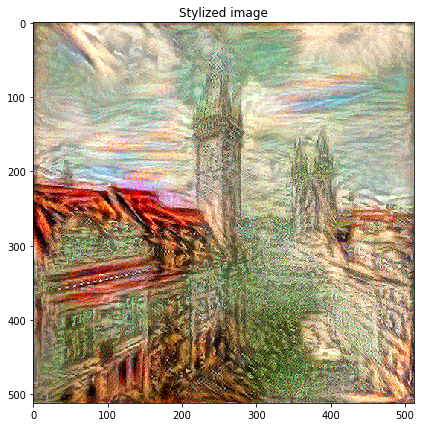

Iteration: 200, style score: 9187260.0, content score: 4458387.5, total loss: 13645648.0


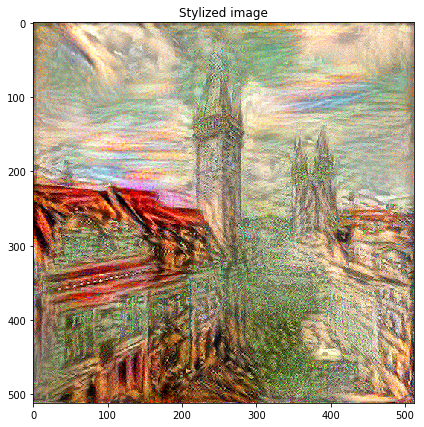

Iteration: 250, style score: 5807030.0, content score: 4014757.75, total loss: 9821788.0


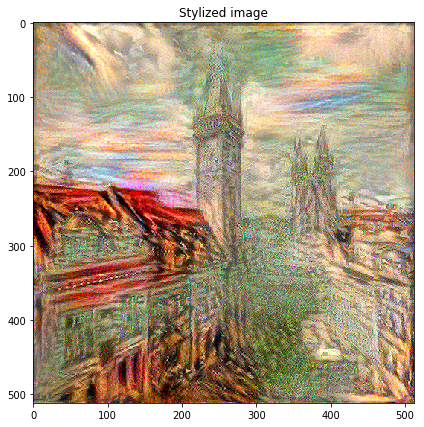

Iteration: 300, style score: 3985800.5, content score: 3576466.0, total loss: 7562266.5


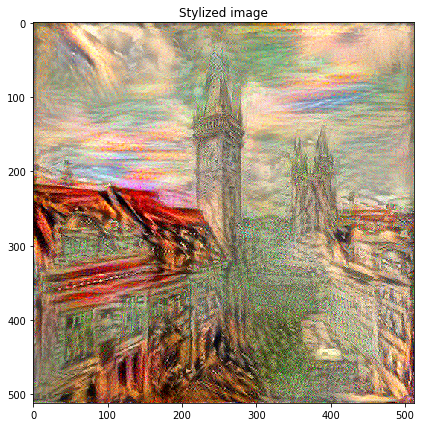

Iteration: 350, style score: 2902602.5, content score: 3215891.5, total loss: 6118494.0


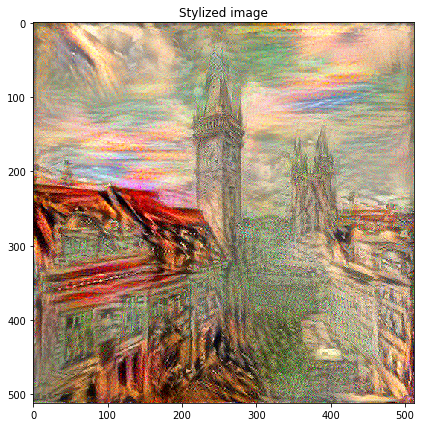

Iteration: 400, style score: 2248035.75, content score: 2917328.25, total loss: 5165364.0


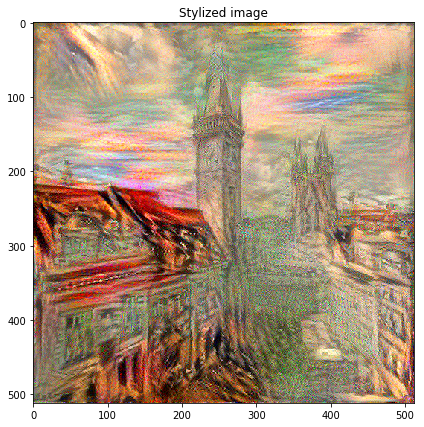

Iteration: 450, style score: 1827494.375, content score: 2680724.25, total loss: 4508218.5


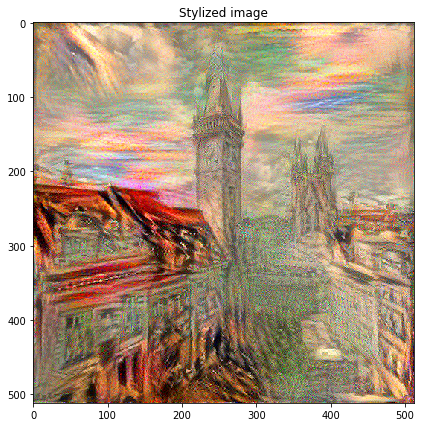

Iteration: 499, style score: 1546468.375, content score: 2500720.0, total loss: 4047188.5


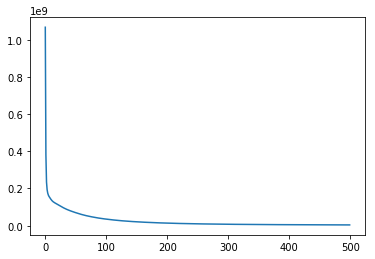

Stylizing of image took 2708.6596336364746s


In [21]:
style_transferred_image, loss = style_transfer(content_path='images'+os.path.sep+'content1.jpg', 
                                     style_path='images'+os.path.sep+'munch-the-scream.jpg',  
                                     vgg_model=vgg_19_model, iterations=500, 
                                     content_weight=1000.0, style_weight=0.1, 
                                     print_images=True, show_loss=True)
style_transferred_image.save('outputs' + os.path.sep + 'content1-munch-the-scream-(vgg19).jpg')

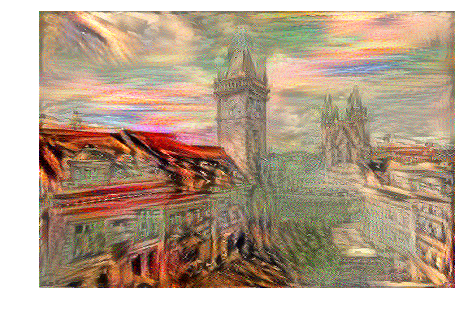

In [22]:
display_style_transferred_image(style_transferred_image, 3)

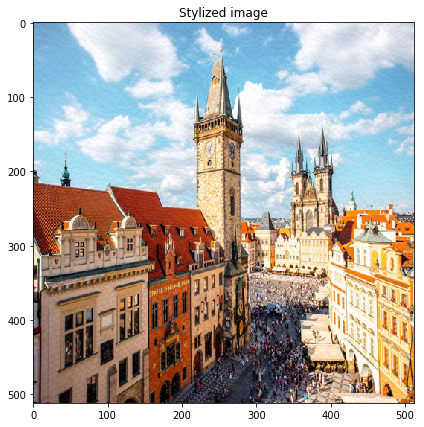

Iteration: 0, style score: 78906904.0, content score: 0.0, total loss: 78906904.0


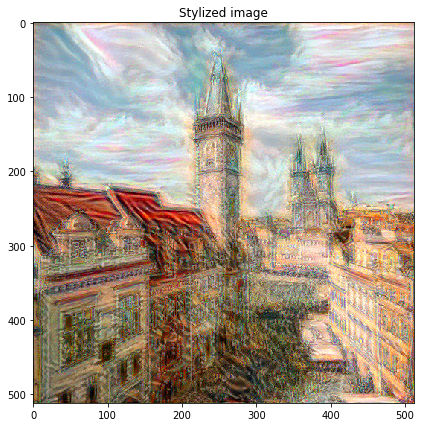

Iteration: 50, style score: 3921006.75, content score: 670750.75, total loss: 4591757.5


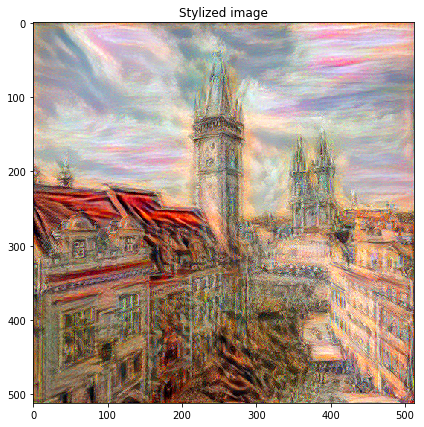

Iteration: 100, style score: 1969461.25, content score: 564227.8125, total loss: 2533689.0


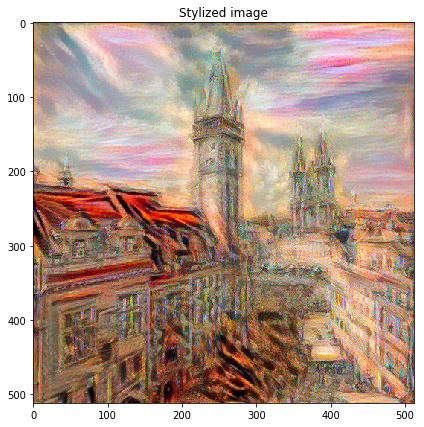

Iteration: 150, style score: 1145584.375, content score: 482159.0, total loss: 1627743.375


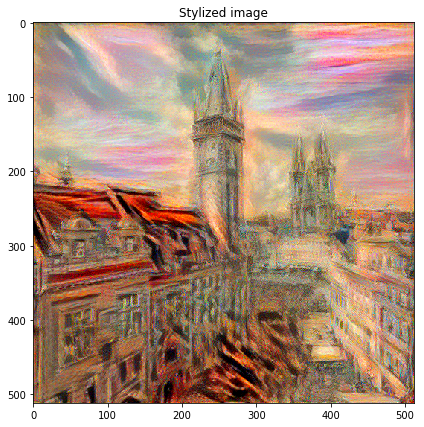

Iteration: 200, style score: 726590.0625, content score: 411362.46875, total loss: 1137952.5


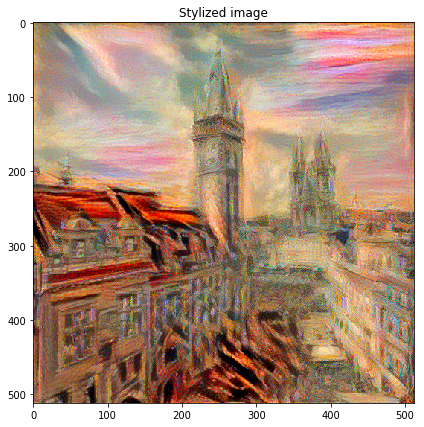

Iteration: 250, style score: 501722.5625, content score: 355759.5, total loss: 857482.0625


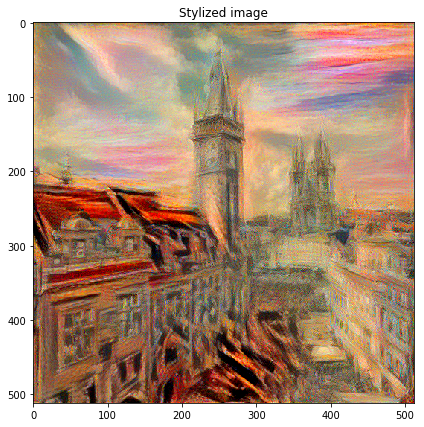

Iteration: 300, style score: 371044.4375, content score: 311360.1875, total loss: 682404.625


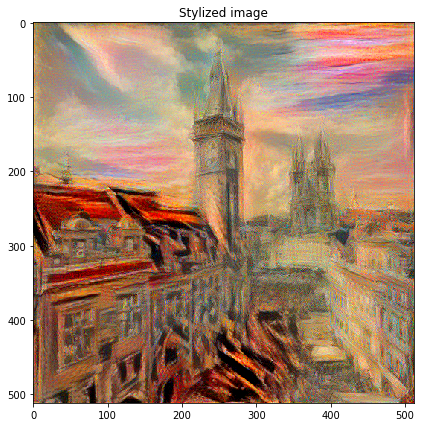

Iteration: 350, style score: 290807.21875, content score: 275132.78125, total loss: 565940.0


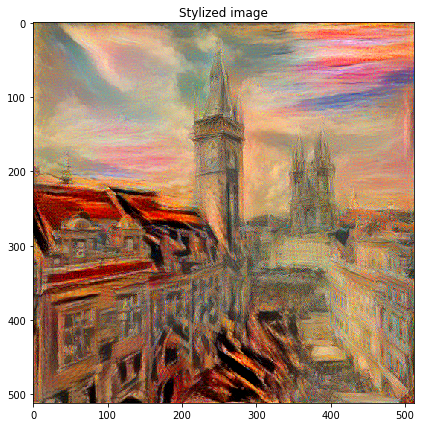

Iteration: 400, style score: 237887.296875, content score: 247530.359375, total loss: 485417.65625


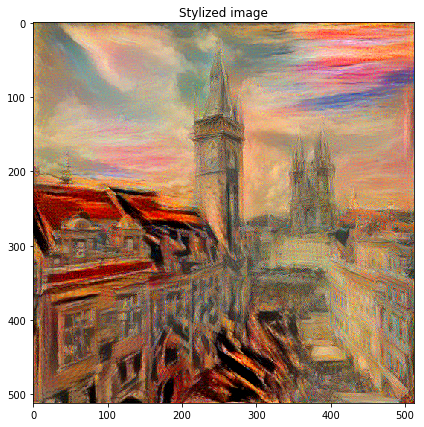

Iteration: 450, style score: 201219.484375, content score: 226830.140625, total loss: 428049.625


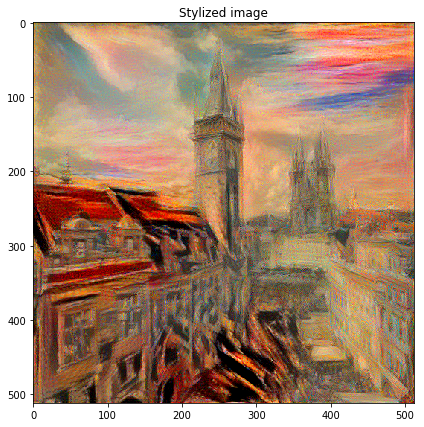

Iteration: 499, style score: 175478.296875, content score: 210822.390625, total loss: 386300.6875


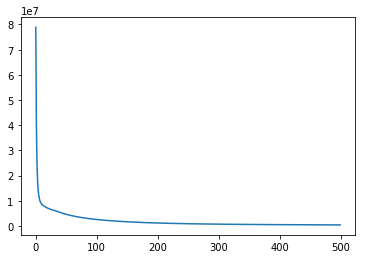

Stylizing of image took 2725.702789783478s


In [23]:
style_transferred_image, loss = style_transfer(content_path='images'+os.path.sep+'content1.jpg', 
                                     style_path='images'+os.path.sep+'munch-the-scream.jpg',  
                                     vgg_model=vgg_16_model, iterations=500, 
                                     content_weight=1000.0, style_weight=0.1, 
                                     print_images=True, show_loss=True)
style_transferred_image.save('outputs' + os.path.sep + 'content1-munch-the-scream-(vgg16).jpg')

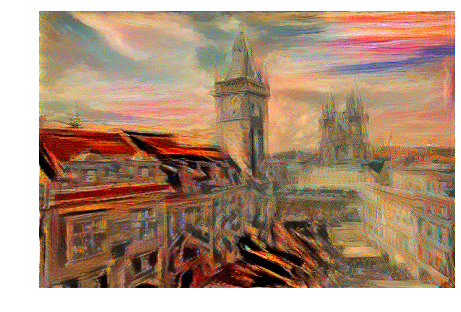

In [24]:
display_style_transferred_image(style_transferred_image, 3)